# About
Face Recognition using Principal Component Analysis. Dataset Used: Pins Face Recognition. [Kaggle Dataset Link](https://www.kaggle.com/hereisburak/pins-face-recognition)

In [61]:
#importing mandatory libraries
import os
from PIL import Image
import matplotlib.pyplot as plt
%matplotlib inline
import glob
import tensorflow as tf
import cv2
import numpy as np
from sklearn.metrics import classification_report
from sklearn.decomposition import PCA
from sklearn.svm import SVC
from sklearn.metrics import confusion_matrix, f1_score, accuracy_score
import pickle
import json
from keras.utils import to_categorical
from sklearn import preprocessing
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import cross_val_score, train_test_split, GridSearchCV
from sklearn.ensemble import AdaBoostClassifier
from sklearn import metrics

In [2]:
os.chdir('/content/drive/MyDrive/Colab Notebooks/Dataset/FaceRecognition')
#!unzip Data.zip

In [3]:
!ls

105_classes_pins_dataset    test_features.npy	train_labels.npy
Data.zip		    test_labels.npy
face_recognition_model.pkl  train_features.npy


In [4]:
#viewing the images in the dataset
person_dict = {}
Folder = "105_classes_pins_dataset/"
for folder in glob.glob(Folder+"/*"):
  person = folder.split('/')[1].split('_')[1]
  person_dict[person] = []
  for image_path in glob.glob(folder+"/*.jpg"):
    person_dict[person].append(image_path)
    

In [5]:
#printing the name of unique persons
for person in person_dict.keys():
  print(person)

print("Total number of persons", len(person_dict.keys()))

Adriana Lima
Alex Lawther
Alexandra Daddario
Alvaro Morte
Amanda Crew
Andy Samberg
Anne Hathaway
Anthony Mackie
Avril Lavigne
Ben Affleck
Bill Gates
Bobby Morley
Brenton Thwaites
Brian J. Smith
Brie Larson
Chris Evans
Chris Hemsworth
Chris Pratt
Christian Bale
Cristiano Ronaldo
Danielle Panabaker
Dominic Purcell
Dwayne Johnson
Eliza Taylor
Elizabeth Lail
Emilia Clarke
Emma Stone
Emma Watson
Gwyneth Paltrow
Henry Cavil
Hugh Jackman
Inbar Lavi
Irina Shayk
Jake Mcdorman
Jason Momoa
Jennifer Lawrence
Jeremy Renner
Jessica Barden
Jimmy Fallon
Johnny Depp
Josh Radnor
Katharine Mcphee
Katherine Langford
Keanu Reeves
Krysten Ritter
Leonardo DiCaprio
Lili Reinhart
Lindsey Morgan
Lionel Messi
Logan Lerman
Madelaine Petsch
Maisie Williams
Maria Pedraza
Marie Avgeropoulos
Mark Ruffalo
Mark Zuckerberg
Megan Fox
Miley Cyrus
Millie Bobby Brown
Morena Baccarin
Morgan Freeman
Nadia Hilker
Natalie Dormer
Natalie Portman
Neil Patrick Harris
Pedro Alonso
Penn Badgley
Rami Malek
Rebecca Ferguson
Richard Ha

Person name : Adriana Lima


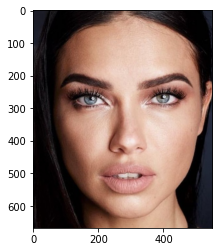

Person name : Adriana Lima


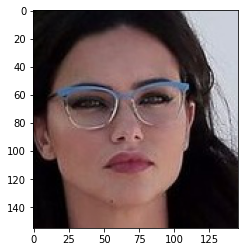

Person name : Alex Lawther


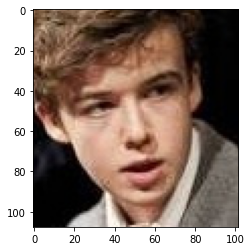

Person name : Alex Lawther


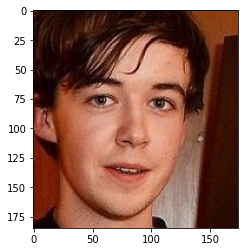

Person name : Alexandra Daddario


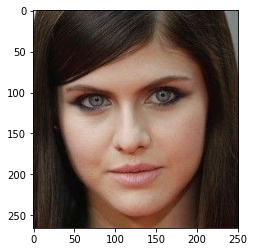

Person name : Alexandra Daddario


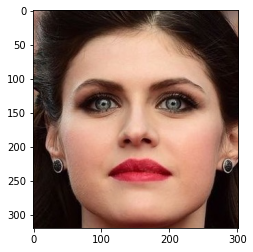

Person name : Alvaro Morte


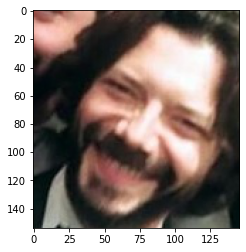

Person name : Alvaro Morte


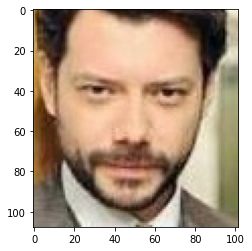

Person name : Amanda Crew


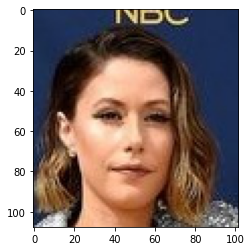

Person name : Amanda Crew


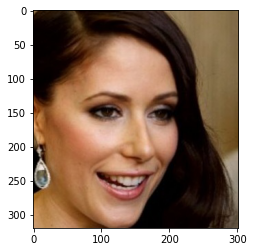

Person name : Andy Samberg


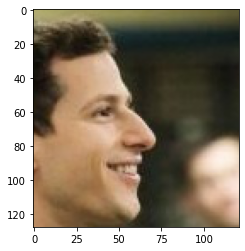

Person name : Andy Samberg


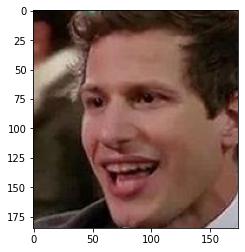

Person name : Anne Hathaway


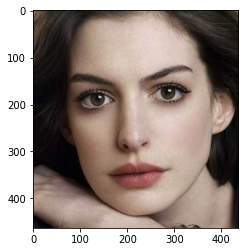

Person name : Anne Hathaway


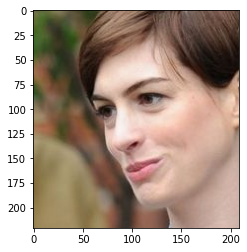

Person name : Anthony Mackie


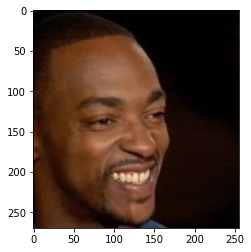

Person name : Anthony Mackie


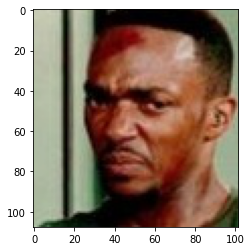

Person name : Avril Lavigne


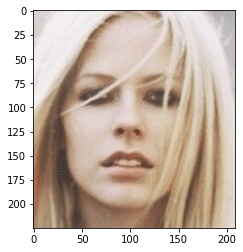

Person name : Avril Lavigne


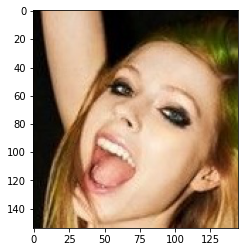

Person name : Ben Affleck


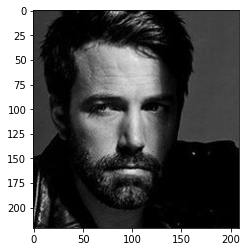

Person name : Ben Affleck


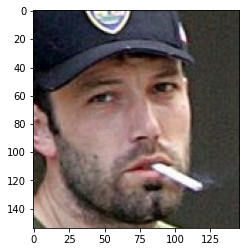

Person name : Bill Gates


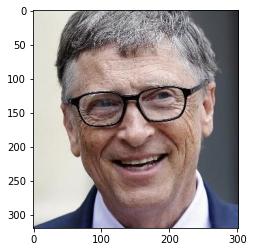

Person name : Bill Gates


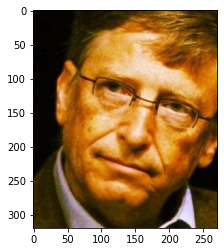

Person name : Bobby Morley


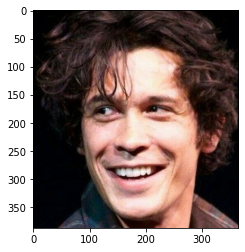

Person name : Bobby Morley


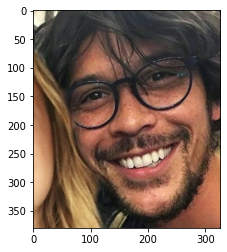

Person name : Brenton Thwaites


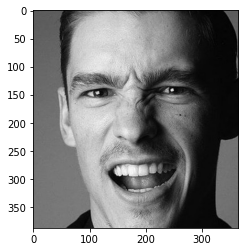

Person name : Brenton Thwaites


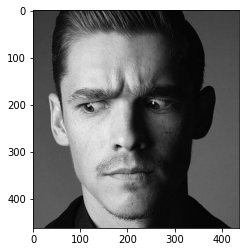

Person name : Brian J. Smith


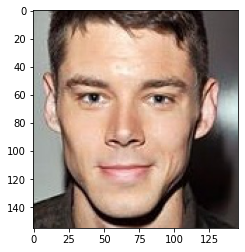

Person name : Brian J. Smith


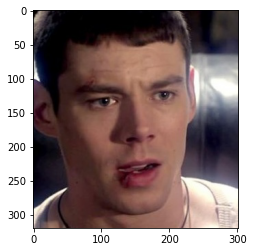

Person name : Brie Larson


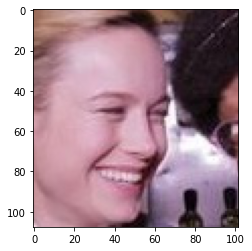

Person name : Brie Larson


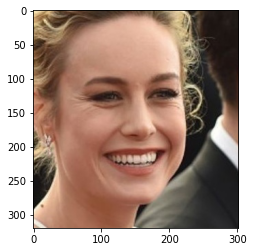

Person name : Chris Evans


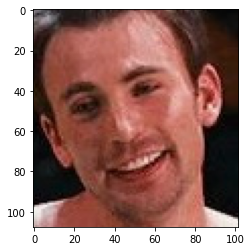

Person name : Chris Evans


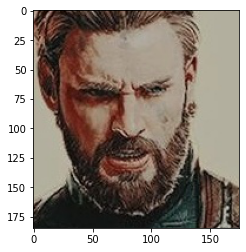

Person name : Chris Hemsworth


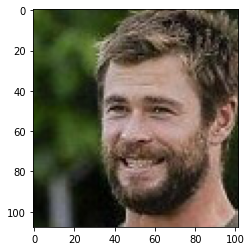

Person name : Chris Hemsworth


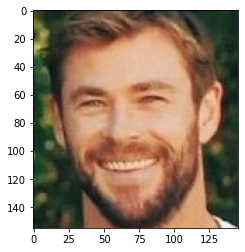

Person name : Chris Pratt


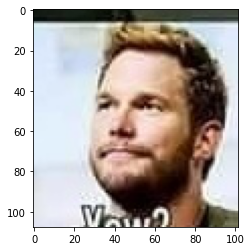

Person name : Chris Pratt


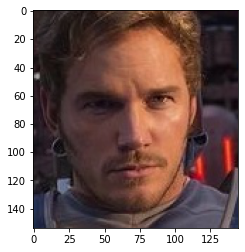

Person name : Christian Bale


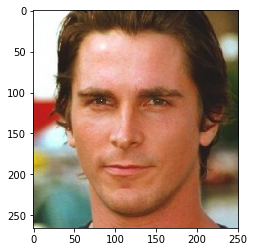

Person name : Christian Bale


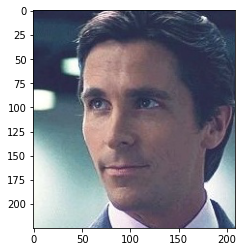

Person name : Cristiano Ronaldo


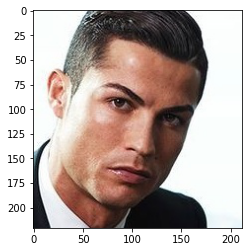

Person name : Cristiano Ronaldo


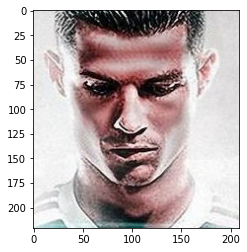

Person name : Danielle Panabaker


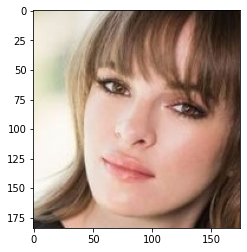

Person name : Danielle Panabaker


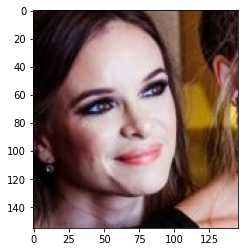

Person name : Dominic Purcell


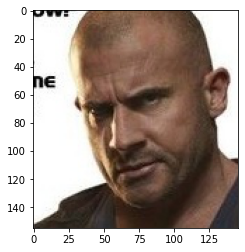

Person name : Dominic Purcell


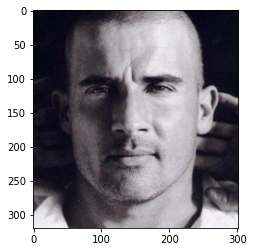

Person name : Dwayne Johnson


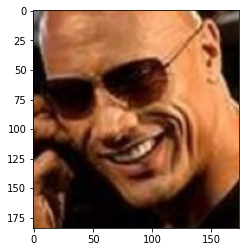

Person name : Dwayne Johnson


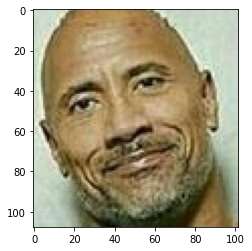

Person name : Eliza Taylor


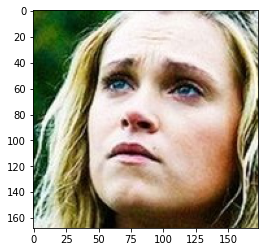

Person name : Eliza Taylor


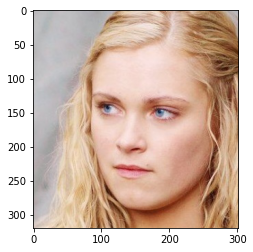

Person name : Elizabeth Lail


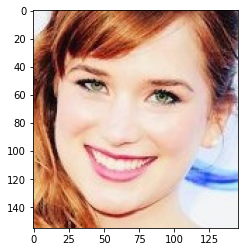

Person name : Elizabeth Lail


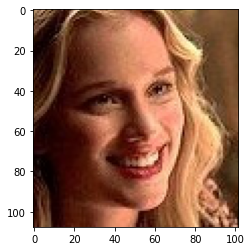

Person name : Emilia Clarke


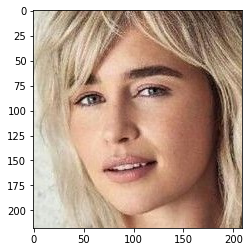

Person name : Emilia Clarke


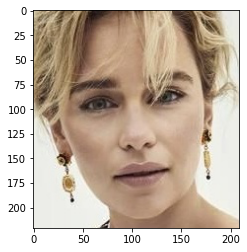

Person name : Emma Stone


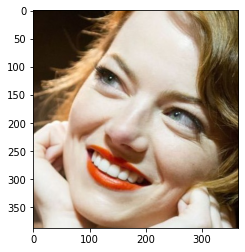

Person name : Emma Stone


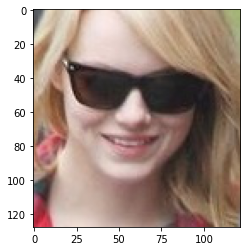

Person name : Emma Watson


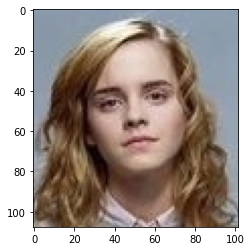

Person name : Emma Watson


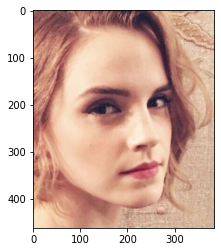

Person name : Gwyneth Paltrow


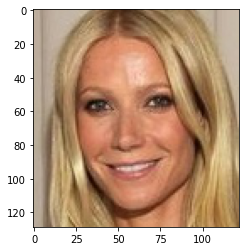

Person name : Gwyneth Paltrow


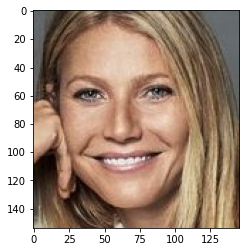

Person name : Henry Cavil


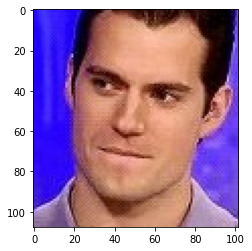

Person name : Henry Cavil


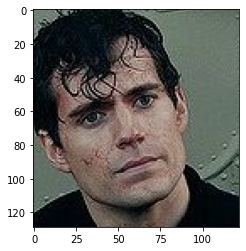

Person name : Hugh Jackman


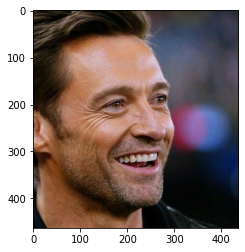

Person name : Hugh Jackman


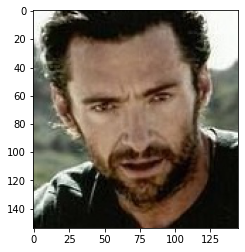

Person name : Inbar Lavi


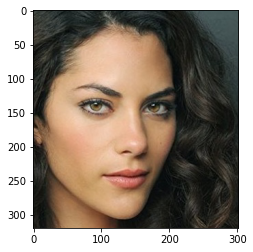

Person name : Inbar Lavi


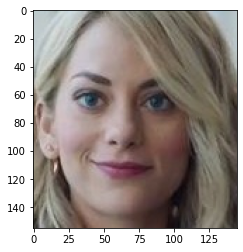

Person name : Irina Shayk


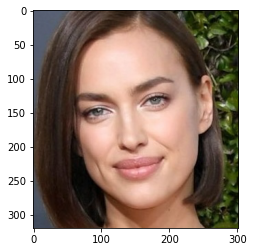

Person name : Irina Shayk


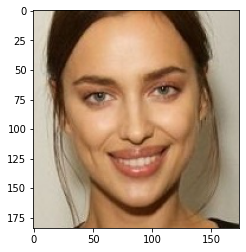

Person name : Jake Mcdorman


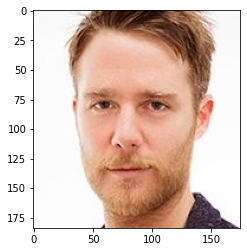

Person name : Jake Mcdorman


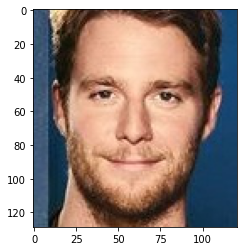

Person name : Jason Momoa


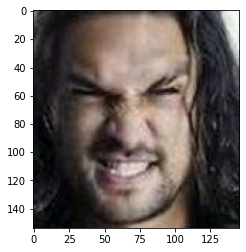

Person name : Jason Momoa


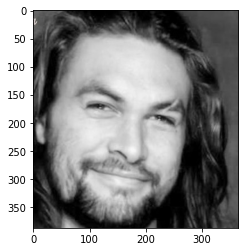

Person name : Jennifer Lawrence


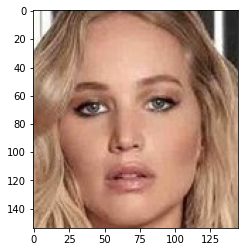

Person name : Jennifer Lawrence


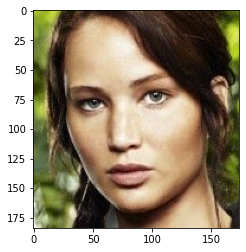

Person name : Jeremy Renner


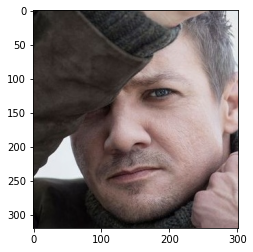

Person name : Jeremy Renner


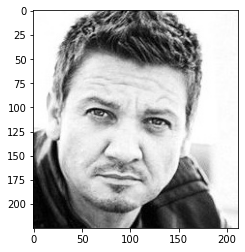

Person name : Jessica Barden


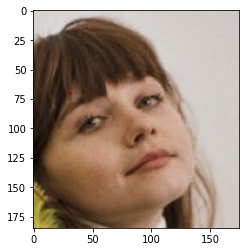

Person name : Jessica Barden


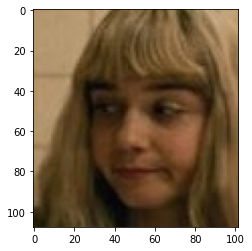

Person name : Jimmy Fallon


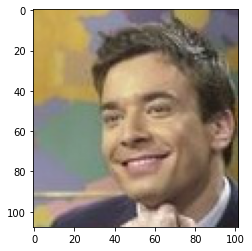

Person name : Jimmy Fallon


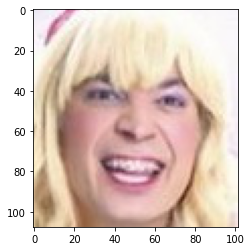

Person name : Johnny Depp


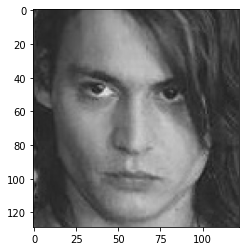

Person name : Johnny Depp


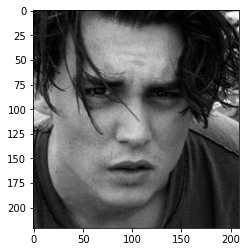

Person name : Josh Radnor


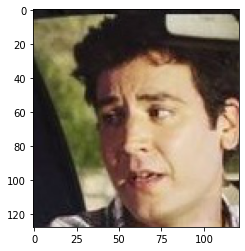

Person name : Josh Radnor


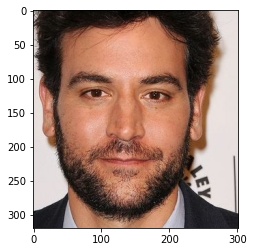

Person name : Katharine Mcphee


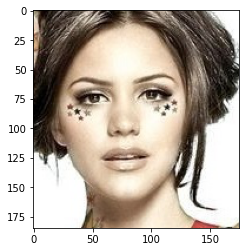

Person name : Katharine Mcphee


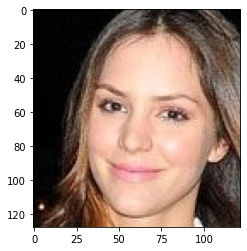

Person name : Katherine Langford


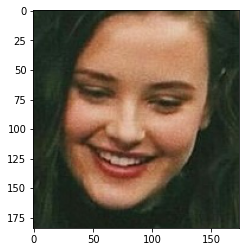

Person name : Katherine Langford


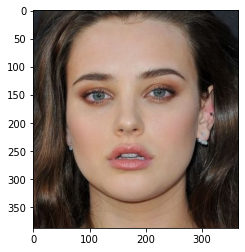

Person name : Keanu Reeves


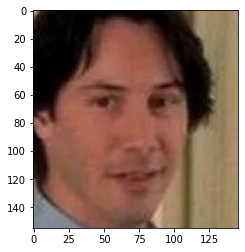

Person name : Keanu Reeves


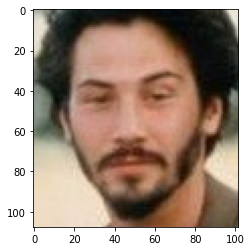

Person name : Krysten Ritter


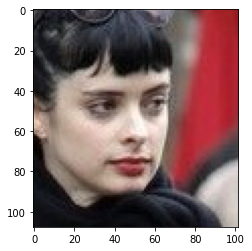

Person name : Krysten Ritter


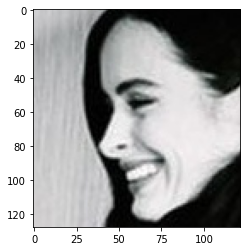

Person name : Leonardo DiCaprio


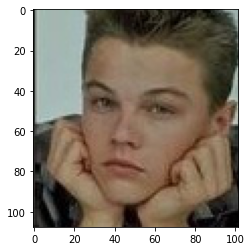

Person name : Leonardo DiCaprio


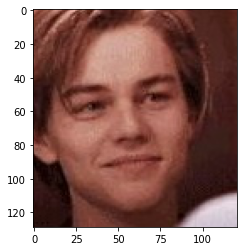

Person name : Lili Reinhart


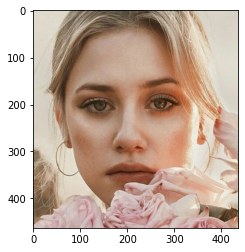

Person name : Lili Reinhart


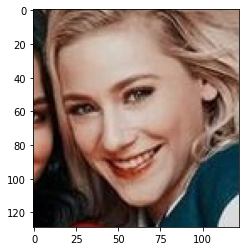

Person name : Lindsey Morgan


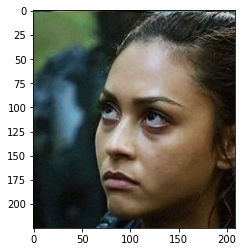

Person name : Lindsey Morgan


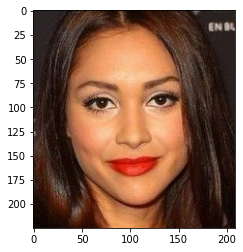

Person name : Lionel Messi


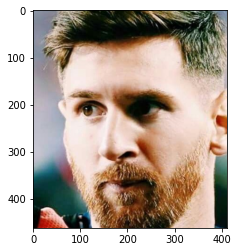

Person name : Lionel Messi


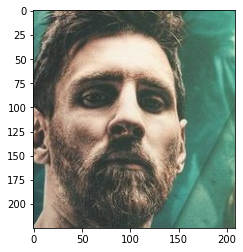

Person name : Logan Lerman


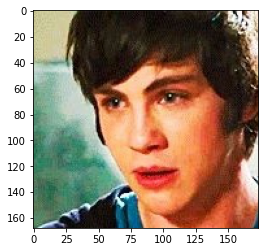

Person name : Logan Lerman


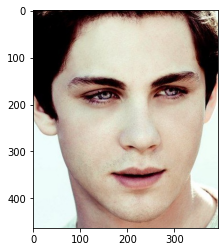

Person name : Madelaine Petsch


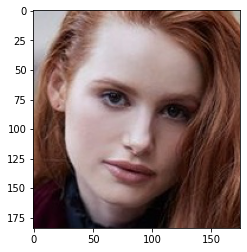

Person name : Madelaine Petsch


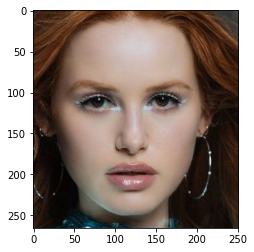

Person name : Maisie Williams


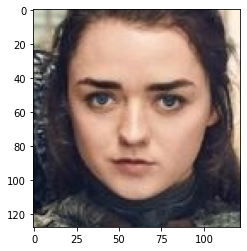

Person name : Maisie Williams


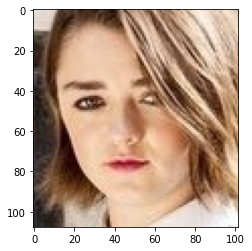

Person name : Maria Pedraza


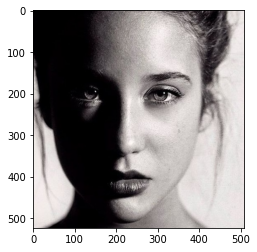

Person name : Maria Pedraza


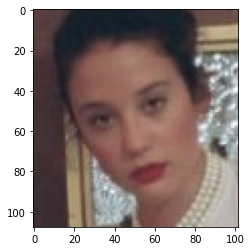

Person name : Marie Avgeropoulos


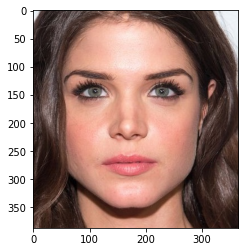

Person name : Marie Avgeropoulos


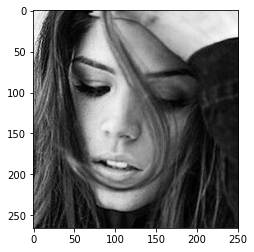

Person name : Mark Ruffalo


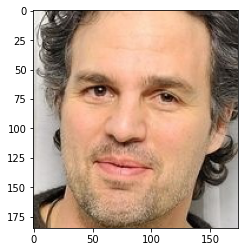

Person name : Mark Ruffalo


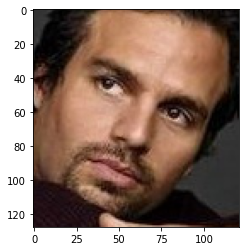

Person name : Mark Zuckerberg


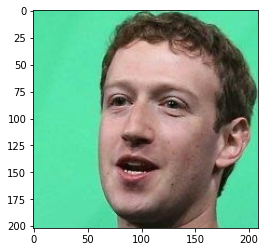

Person name : Mark Zuckerberg


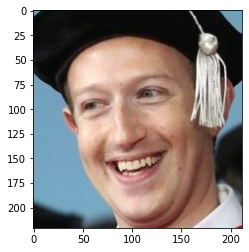

Person name : Megan Fox


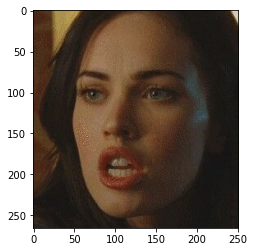

Person name : Megan Fox


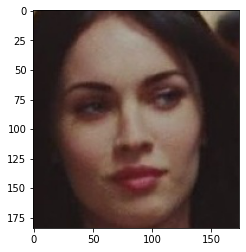

Person name : Miley Cyrus


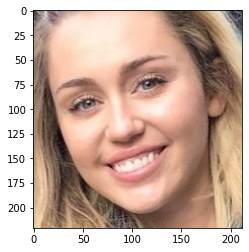

Person name : Miley Cyrus


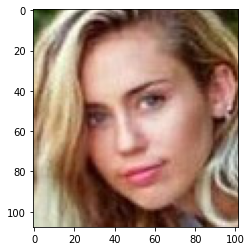

Person name : Millie Bobby Brown


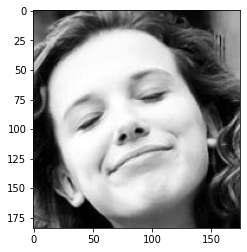

Person name : Millie Bobby Brown


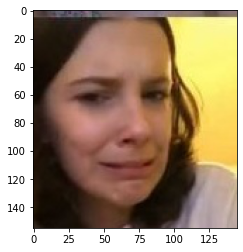

Person name : Morena Baccarin


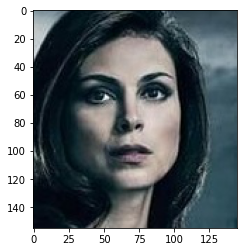

Person name : Morena Baccarin


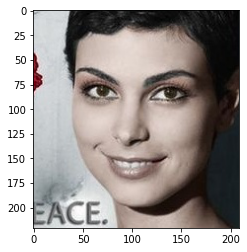

Person name : Morgan Freeman


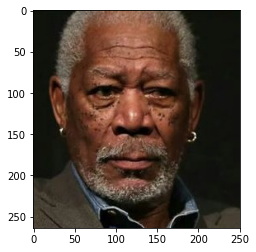

Person name : Morgan Freeman


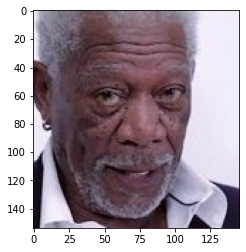

Person name : Nadia Hilker


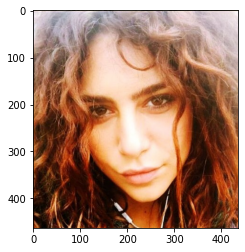

Person name : Nadia Hilker


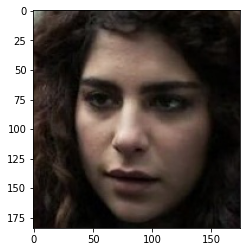

Person name : Natalie Dormer


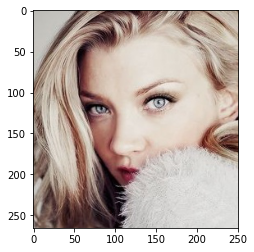

Person name : Natalie Dormer


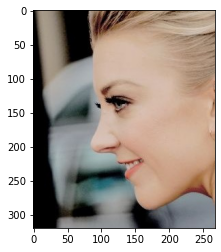

Person name : Natalie Portman


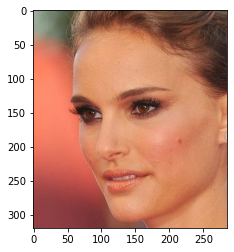

Person name : Natalie Portman


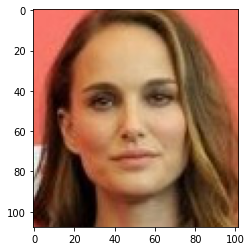

Person name : Neil Patrick Harris


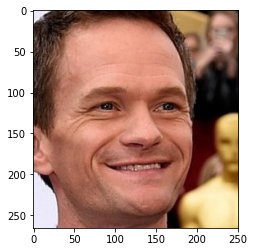

Person name : Neil Patrick Harris


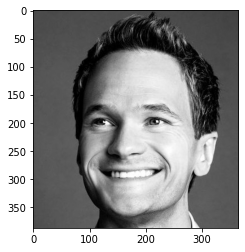

Person name : Pedro Alonso


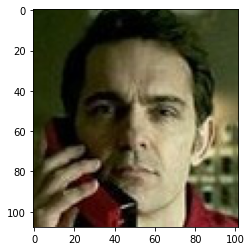

Person name : Pedro Alonso


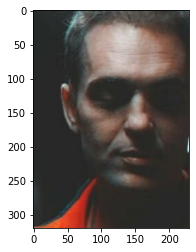

Person name : Penn Badgley


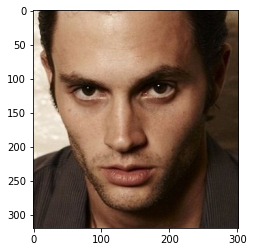

Person name : Penn Badgley


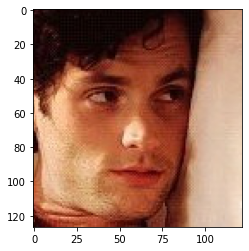

Person name : Rami Malek


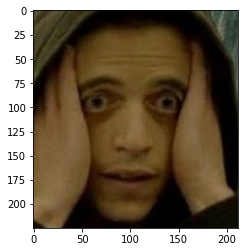

Person name : Rami Malek


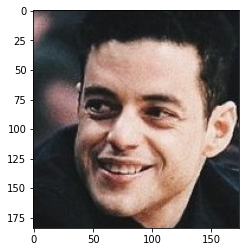

Person name : Rebecca Ferguson


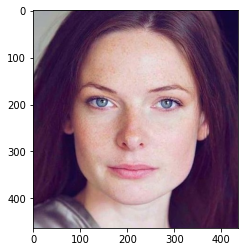

Person name : Rebecca Ferguson


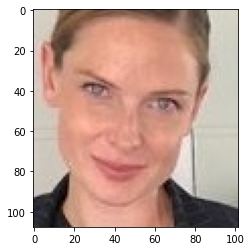

Person name : Richard Harmon


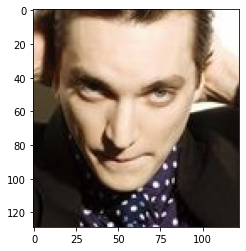

Person name : Richard Harmon


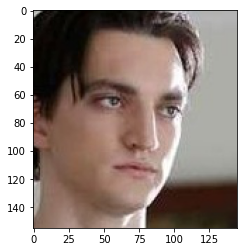

Person name : Rihanna


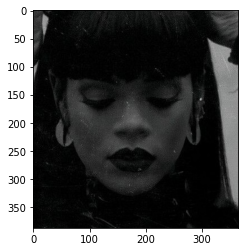

Person name : Rihanna


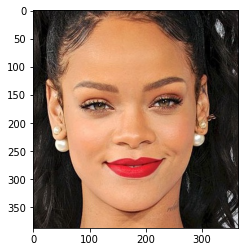

Person name : Robert De Niro


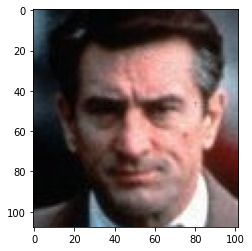

Person name : Robert De Niro


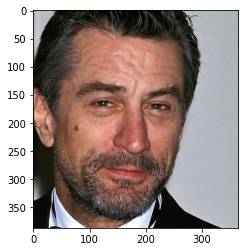

Person name : Robert Downey Jr


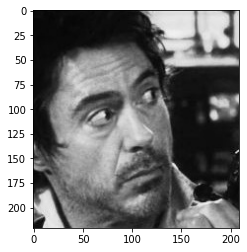

Person name : Robert Downey Jr


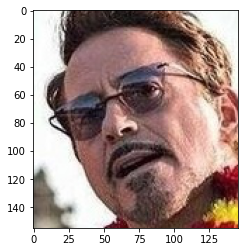

Person name : Sarah Wayne Callies


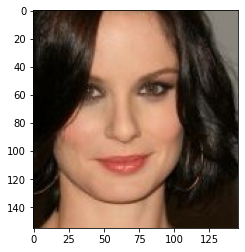

Person name : Sarah Wayne Callies


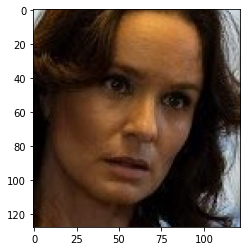

Person name : Selena Gomez


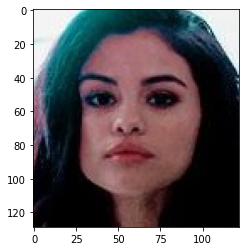

Person name : Selena Gomez


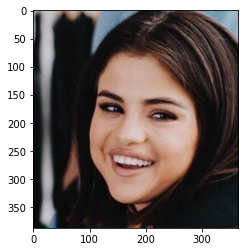

Person name : Shakira Isabel Mebarak


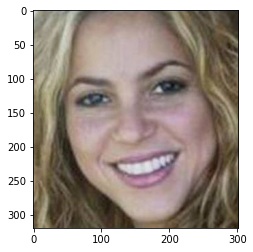

Person name : Shakira Isabel Mebarak


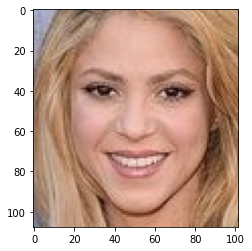

Person name : Sophie Turner


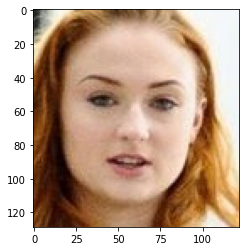

Person name : Sophie Turner


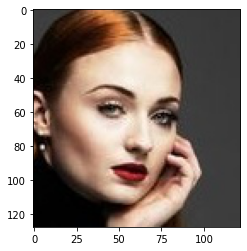

Person name : Stephen Amell


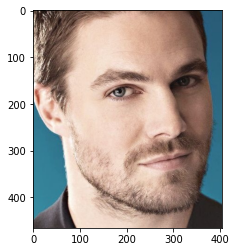

Person name : Stephen Amell


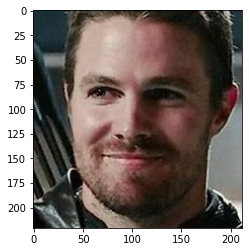

Person name : Taylor Swift


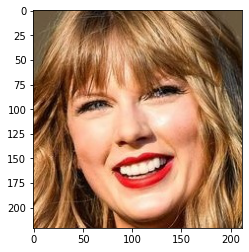

Person name : Taylor Swift


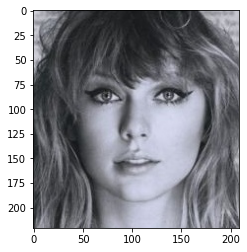

Person name : Tom Cruise


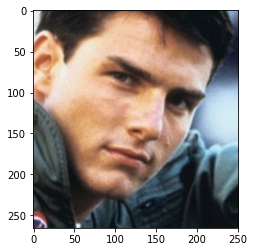

Person name : Tom Cruise


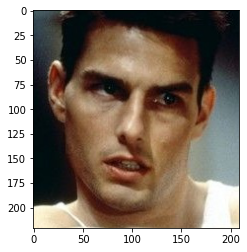

Person name : Tom Hardy


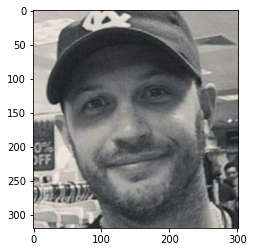

Person name : Tom Hardy


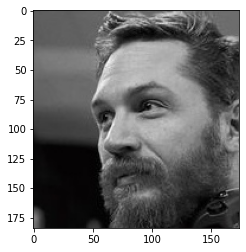

Person name : Tom Hiddleston


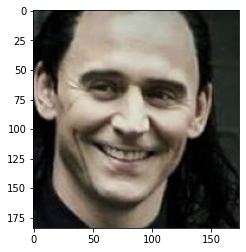

Person name : Tom Hiddleston


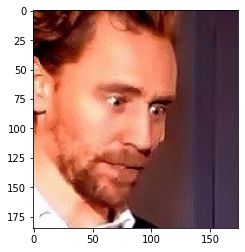

Person name : Tom Holland


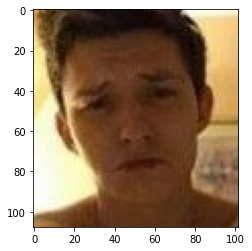

Person name : Tom Holland


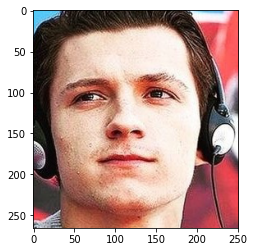

Person name : Tuppence Middleton


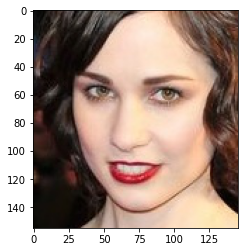

Person name : Tuppence Middleton


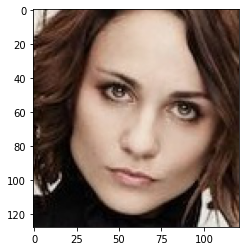

Person name : Ursula Corbero


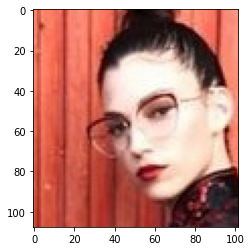

Person name : Ursula Corbero


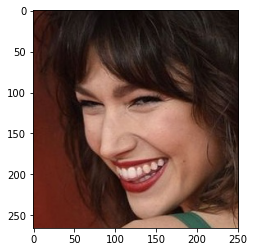

Person name : Wentworth Miller


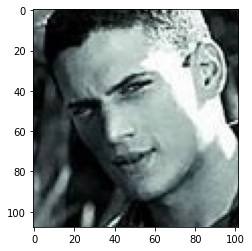

Person name : Wentworth Miller


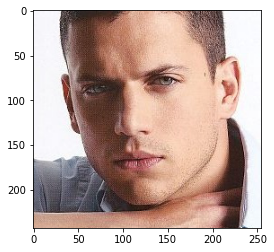

Person name : Zac Efron


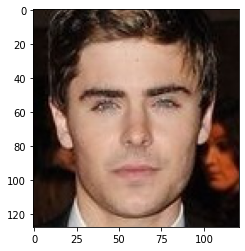

Person name : Zac Efron


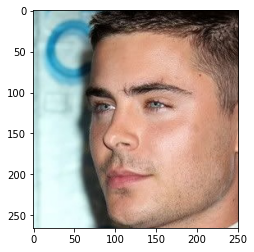

Person name : Zendaya


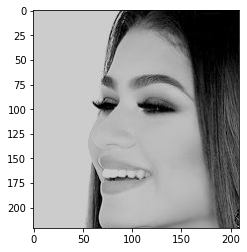

Person name : Zendaya


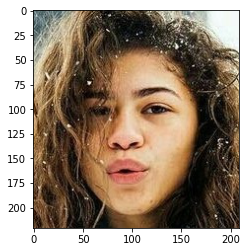

Person name : Zoe Saldana


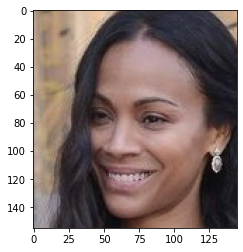

Person name : Zoe Saldana


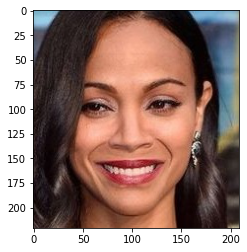

Person name : alycia dabnem carey


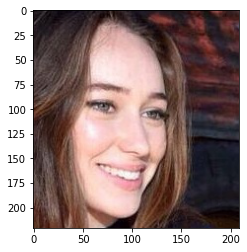

Person name : alycia dabnem carey


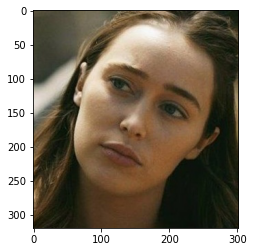

Person name : amber heard


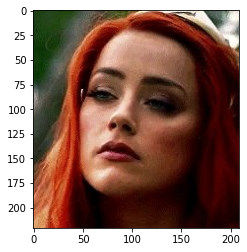

Person name : amber heard


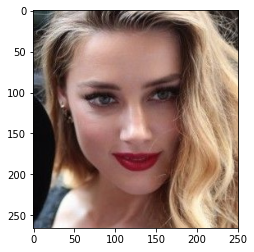

Person name : barack obama


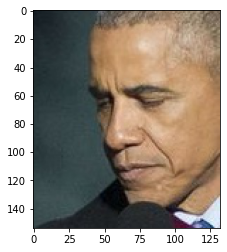

Person name : barack obama


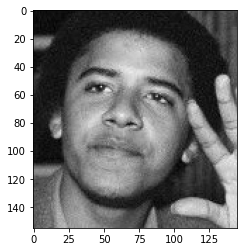

Person name : barbara palvin


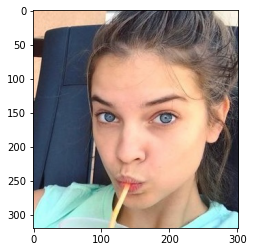

Person name : barbara palvin


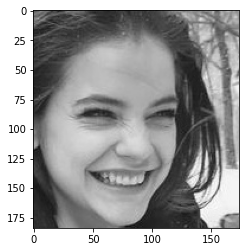

Person name : camila mendes


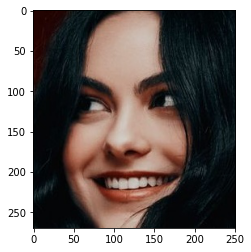

Person name : camila mendes


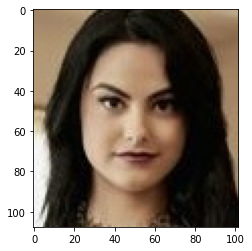

Person name : elizabeth olsen


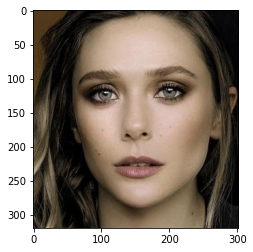

Person name : elizabeth olsen


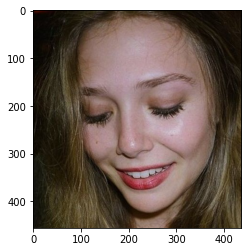

Person name : ellen page


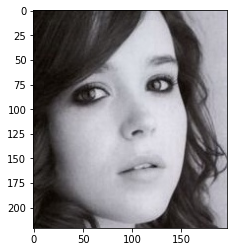

Person name : ellen page


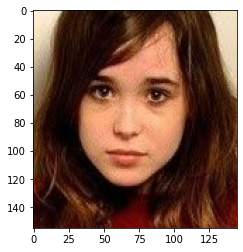

Person name : elon musk


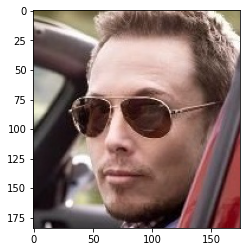

Person name : elon musk


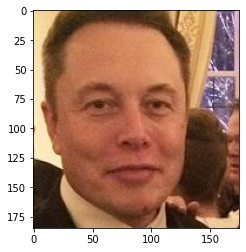

Person name : gal gadot


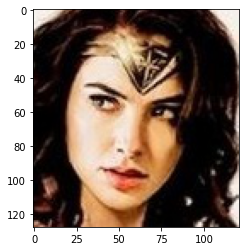

Person name : gal gadot


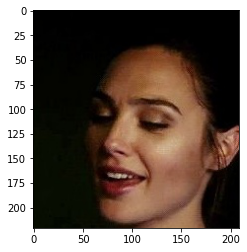

Person name : grant gustin


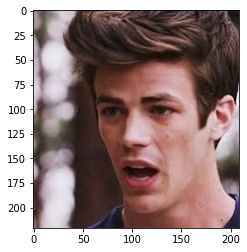

Person name : grant gustin


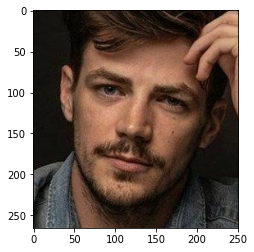

Person name : jeff bezos


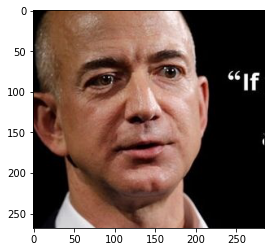

Person name : jeff bezos


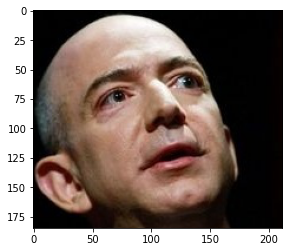

Person name : kiernen shipka


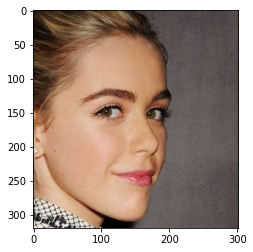

Person name : kiernen shipka


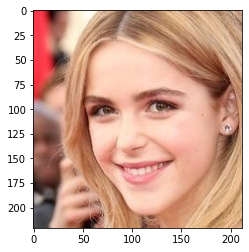

Person name : margot robbie


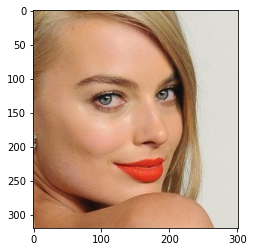

Person name : margot robbie


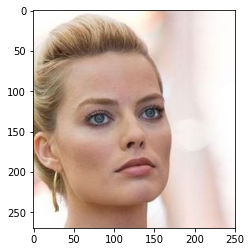

Person name : melissa fumero


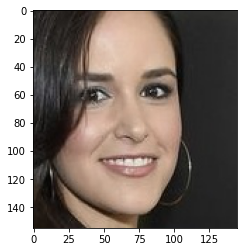

Person name : melissa fumero


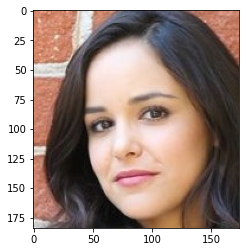

Person name : scarlett johansson


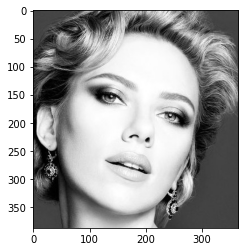

Person name : scarlett johansson


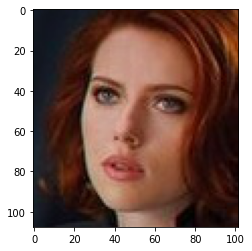

Person name : tom ellis


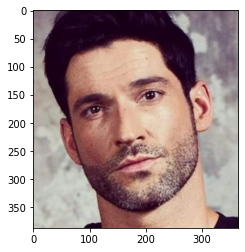

Person name : tom ellis


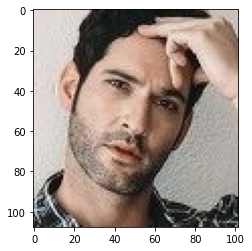

In [6]:
#plotting 5 samples from each person
for key in person_dict.keys():
  for idx in range(2):
    print("Person name : {}".format(key))
    image = Image.open(person_dict[key][idx])
    plt.imshow(image)
    plt.show()


In [7]:
 #converting the people to categorical:
people_label = {people:count for count,people in enumerate(person_dict.keys())}
print(people_label)

{'Adriana Lima': 0, 'Alex Lawther': 1, 'Alexandra Daddario': 2, 'Alvaro Morte': 3, 'Amanda Crew': 4, 'Andy Samberg': 5, 'Anne Hathaway': 6, 'Anthony Mackie': 7, 'Avril Lavigne': 8, 'Ben Affleck': 9, 'Bill Gates': 10, 'Bobby Morley': 11, 'Brenton Thwaites': 12, 'Brian J. Smith': 13, 'Brie Larson': 14, 'Chris Evans': 15, 'Chris Hemsworth': 16, 'Chris Pratt': 17, 'Christian Bale': 18, 'Cristiano Ronaldo': 19, 'Danielle Panabaker': 20, 'Dominic Purcell': 21, 'Dwayne Johnson': 22, 'Eliza Taylor': 23, 'Elizabeth Lail': 24, 'Emilia Clarke': 25, 'Emma Stone': 26, 'Emma Watson': 27, 'Gwyneth Paltrow': 28, 'Henry Cavil': 29, 'Hugh Jackman': 30, 'Inbar Lavi': 31, 'Irina Shayk': 32, 'Jake Mcdorman': 33, 'Jason Momoa': 34, 'Jennifer Lawrence': 35, 'Jeremy Renner': 36, 'Jessica Barden': 37, 'Jimmy Fallon': 38, 'Johnny Depp': 39, 'Josh Radnor': 40, 'Katharine Mcphee': 41, 'Katherine Langford': 42, 'Keanu Reeves': 43, 'Krysten Ritter': 44, 'Leonardo DiCaprio': 45, 'Lili Reinhart': 46, 'Lindsey Morgan'

In [8]:
# checking if each person has equal number of images or not
images_count = []
for person in person_dict.keys():
  images_count.append(len(person_dict[person]))

print("Number of images per class",set(images_count))
print("Total Number of images", sum(images_count))


Number of images per class {131, 133, 135, 138, 139, 141, 146, 148, 150, 152, 154, 156, 158, 159, 160, 161, 162, 166, 167, 169, 171, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 186, 187, 188, 189, 191, 192, 193, 195, 196, 197, 198, 199, 201, 203, 204, 209, 210, 211, 212, 213, 86, 218, 221, 95, 225, 98, 226, 102, 105, 233, 106, 237, 113, 116, 117, 119, 122, 124, 125, 126, 127}
Total Number of images 17534


#Observation
Clearly the number of images for each person is different. Let's create our dataset so that the train_set contains 70% of the entire chunk. It can't be created using conventional train_test split.

In [35]:
#using only 20 images per person for training and 5 for testing
train_images, train_labels, test_images, test_labels = [],[],[],[]
for person in person_dict.keys():
  #train_length = round(0.7* len(person_dict[person]))
  for train_idx in range(0, 20):
    train_image = cv2.imread(person_dict[person][train_idx])
    train_image = cv2.cvtColor(train_image, cv2.COLOR_BGR2GRAY)
    resized_train_image = cv2.resize(train_image, (192, 192),interpolation = cv2.INTER_NEAREST)
    resized_train_image = resized_train_image.flatten()
    train_images.append(resized_train_image)
    train_labels.append(people_label[person])
    print("Processed")

  for test_idx in range(21, 26):
    test_image = cv2.imread(person_dict[person][test_idx])
    test_image = cv2.cvtColor(test_image, cv2.COLOR_BGR2GRAY)
    resized_test_image = cv2.resize(test_image, (192, 192),interpolation = cv2.INTER_NEAREST)
    resized_test_image = resized_test_image.flatten()
    test_images.append(resized_test_image)
    test_labels.append(people_label[person])
    print("Processed")

Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed
Processed


In [63]:
print(np.unique(train_labels))
print(np.unique(test_labels))

[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104]
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104]


In [36]:
# #one hot encoding labels
# train_labels = to_categorical(train_labels)
# test_labels = to_categorical(test_labels)

In [64]:
#printing the shape of arrays
print("Train features shape", np.shape(train_images))
print("Train labels shape", np.shape(train_labels))
print("Test features shape", np.shape(test_images))
print("Test labels shape", np.shape(test_labels))

Train features shape (2100, 36864)
Train labels shape (2100,)
Test features shape (525, 36864)
Test labels shape (525,)


In [38]:
#loading the matrices
#train_images = np.load('train_features.npy')
#train_labels = np.load('train_labels.npy')
#test_features = np.load('test_features.npy')
#test_labels = np.load('test_labels.npy')

In [65]:

#performing PCA
#fitting on a subset of train_images due to ram constraints
pca = PCA(n_components=180,whiten=True, svd_solver='randomized').fit(train_images)

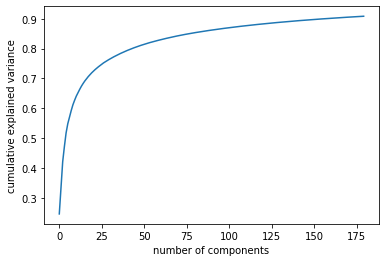

In [66]:
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('number of components')
plt.ylabel('cumulative explained variance');
plt.show()

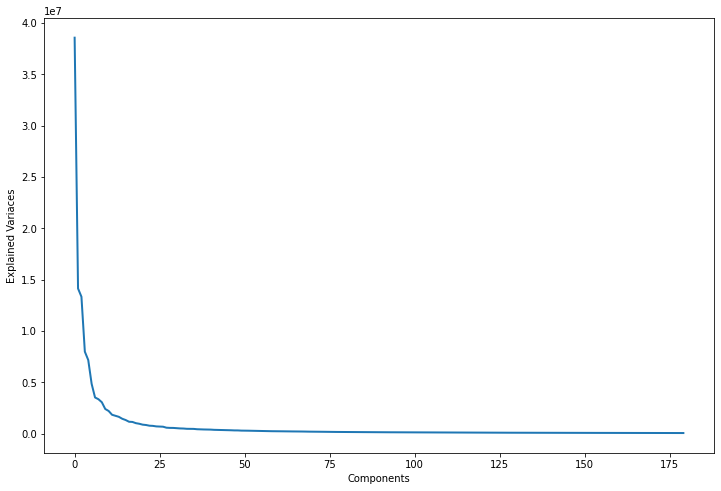

In [67]:
plt.figure(1, figsize=(12,8))
# print(pca.explained_variance_)
plt.plot(pca.explained_variance_, linewidth=2)
plt.xlabel('Components')
plt.ylabel('Explained Variaces')
plt.show()

# Observation
Around 160, we can capture almost > 90% variance.

In [68]:
#helper function to plot eigenfaces
def show_eigenfaces(pca):
	#Displaying Eigenfaces
	fig, axes = plt.subplots(4, 8, figsize=(10, 4),
	                         subplot_kw={'xticks':[], 'yticks':[]})
	for i, ax in enumerate(axes.flat):
	    ax.imshow(pca.components_[i].reshape(192, 192))
	    ax.set_title("Image " + str(i+1))
	plt.show()

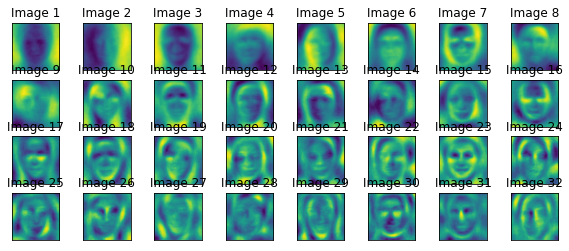

In [69]:
show_eigenfaces(pca)

In [70]:
#projecting training_data to pca
#igenfaces = pca.components_.reshape((160, 96, 96))
X_train_pca = pca.transform(train_images)
X_test_pca = pca.transform(test_images)

In [71]:
svc_wo_hyperparam = SVC()
svc_wo_hyperparam.fit(X_train_pca, train_labels)

SVC(C=1.0, break_ties=False, cache_size=200, class_weight=None, coef0=0.0,
    decision_function_shape='ovr', degree=3, gamma='scale', kernel='rbf',
    max_iter=-1, probability=False, random_state=None, shrinking=True,
    tol=0.001, verbose=False)

In [72]:

y_pred_svc_wo_hyperparam= svc_wo_hyperparam.predict(X_test_pca)

In [73]:
print("accuracy score:{:.2f}%".format(metrics.accuracy_score(test_labels, y_pred_svc_wo_hyperparam)*100))

accuracy score:7.81%


In [89]:
print(classification_report(test_labels, y_pred_svc_wo_hyperparam))

              precision    recall  f1-score   support

           0       0.00      0.00      0.00         5
           1       0.00      0.00      0.00         5
           2       0.00      0.00      0.00         5
           3       0.00      0.00      0.00         5
           4       0.00      0.00      0.00         5
           5       0.00      0.00      0.00         5
           6       0.17      0.20      0.18         5
           7       1.00      0.20      0.33         5
           8       0.00      0.00      0.00         5
           9       0.00      0.00      0.00         5
          10       0.50      0.20      0.29         5
          11       0.00      0.00      0.00         5
          12       0.00      0.00      0.00         5
          13       0.00      0.00      0.00         5
          14       0.00      0.00      0.00         5
          15       0.00      0.00      0.00         5
          16       0.00      0.00      0.00         5
          17       0.20    

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [75]:
#fitting SVC with rbf kernel to it without hyperparameter tuning
#clf = SVC(decision_function_shape="ovo",kernel='rbf', C=1000, gamma=0.001)
#clf.fit(X_train_pca, train_labels)

grid_params = {
         'C': [1e-2 ,1e-1, 1e1 ,1e2, 1e3, 5e3, 1e4, 5e4, 1e5],
          'gamma': [0.0001, 0.0005, 0.001, 0.005, 0.01, 0.1],
}

SVC_model = GridSearchCV(SVC(kernel='rbf',class_weight='balanced'), grid_params,verbose=1, cv=3, n_jobs=8).fit(X_train_pca, train_labels).best_estimator_


Fitting 3 folds for each of 54 candidates, totalling 162 fits


[Parallel(n_jobs=8)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:   43.6s
[Parallel(n_jobs=8)]: Done 162 out of 162 | elapsed:  3.1min finished


In [76]:

LR = LogisticRegression(random_state=0, solver='lbfgs', multi_class='multinomial',max_iter=100000).fit(X_train_pca, train_labels)

In [77]:
#predicting people's name based on testing.
X_test_pca = pca.transform(test_images)
y_pred_svc= SVC_model.predict(X_test_pca)
y_pred_logreg = LR.predict(X_test_pca)

In [84]:
print("accuracy score : SVC with hyper param :{:.2f}%".format(metrics.accuracy_score(test_labels, y_pred_svc)*100))

accuracy score : SVC with hyper param :6.10%


In [85]:
print("accuracy score : Logistic Regression :{:.2f}%".format(metrics.accuracy_score(test_labels, y_pred_logreg)*100))

accuracy score : Logistic Regression :7.24%


In [90]:
print(classification_report(test_labels,y_pred_logreg))

              precision    recall  f1-score   support

           0       0.00      0.00      0.00         5
           1       0.00      0.00      0.00         5
           2       0.00      0.00      0.00         5
           3       0.00      0.00      0.00         5
           4       0.00      0.00      0.00         5
           5       0.33      0.20      0.25         5
           6       0.00      0.00      0.00         5
           7       0.25      0.20      0.22         5
           8       0.00      0.00      0.00         5
           9       0.00      0.00      0.00         5
          10       0.00      0.00      0.00         5
          11       0.00      0.00      0.00         5
          12       0.00      0.00      0.00         5
          13       0.00      0.00      0.00         5
          14       0.00      0.00      0.00         5
          15       0.25      0.20      0.22         5
          16       0.00      0.00      0.00         5
          17       0.12    

In [78]:
round(SVC_model.score(X_test_pca,test_labels), 4)

0.061

In [79]:
#classification report
round(LR.score(X_test_pca,test_labels), 4)

0.0724

# Observation
Not enough score via SVC and Logistic regression. Let's try adaboost

In [80]:
Ensemble_model = AdaBoostClassifier()
Ensemble_model.fit(X_train_pca, train_labels)

AdaBoostClassifier(algorithm='SAMME.R', base_estimator=None, learning_rate=1.0,
                   n_estimators=50, random_state=None)

In [86]:
# grid_params = {
#          'learning_rate': [1e3, 5e3, 1e4, 5e4, 1e5],
# }
# AdaBoostClassifier().get_params().keys()
y_pred_ab = Ensemble_model.predict(X_test_pca)

In [82]:
round(Ensemble_model.score(X_test_pca,test_labels), 4)

0.0305

In [87]:
print("accuracy score : Adaboost :{:.2f}%".format(metrics.accuracy_score(test_labels, y_pred_ab)*100))

accuracy score : Adaboost :3.05%


In [88]:
#saving the best model for serving i.e LR here
with open('face_recognition_model.pkl','wb') as f:
    pickle.dump(svc_wo_hyperparam,f)

# Scope of Improvement
Since this is a challenging dataset hence ML models are not very useful, you can try Siamese networks with triplet loss for better accuracy.